$\newcommand{\xv}{\mathbf{x}}
\newcommand{\Xv}{\mathbf{X}}
\newcommand{\yv}{\mathbf{y}}
\newcommand{\Yv}{\mathbf{Y}}
\newcommand{\zv}{\mathbf{z}}
\newcommand{\av}{\mathbf{a}}
\newcommand{\Wv}{\mathbf{W}}
\newcommand{\wv}{\mathbf{w}}
\newcommand{\gv}{\mathbf{g}}
\newcommand{\Hv}{\mathbf{H}}
\newcommand{\dv}{\mathbf{d}}
\newcommand{\Vv}{\mathbf{V}}
\newcommand{\vv}{\mathbf{v}}
\newcommand{\tv}{\mathbf{t}}
\newcommand{\Tv}{\mathbf{T}}
\newcommand{\zv}{\mathbf{z}}
\newcommand{\Zv}{\mathbf{Z}}
\newcommand{\muv}{\boldsymbol{\mu}}
\newcommand{\sigmav}{\boldsymbol{\sigma}}
\newcommand{\phiv}{\boldsymbol{\phi}}
\newcommand{\Phiv}{\boldsymbol{\Phi}}
\newcommand{\Sigmav}{\boldsymbol{\Sigma}}
\newcommand{\Lambdav}{\boldsymbol{\Lambda}}
\newcommand{\half}{\frac{1}{2}}
\newcommand{\argmax}[1]{\underset{#1}{\operatorname{argmax}}}
\newcommand{\argmin}[1]{\underset{#1}{\operatorname{argmin}}}
\newcommand{\dimensionbar}[1]{\underset{#1}{\operatorname{|}}}
$

# 09.1 Neural Network Class

* 09.1 Fixed bugs in NeuralNetwork class. Added link to 09code.zip

Today we will design and implement a new python class that defines our neural network computations.  We develop our code in small steps as an introduction to object-oriented programming in python.

What is the simplest class you can define?

In [13]:
class Silly:
    
    def __init__(self, my_name):
        self.my_name = my_name
        
    def __str__(self):
        return f'This is a Silly object for {self.my_name}'
    
    def __repr__(self):
        return f'Silly(\'{self.my_name}\')'

In [15]:
a = Silly('Chuck')
a
print(a)

This is a Silly object for Chuck


In [45]:
a.date = 'today'

In [46]:
a.date

'today'

In [4]:
dir(a)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__']

First, let's do the fun part, the design of the API, the methods we will use.

What will the constructor look like?  We will need to specify the number of inputs, the numbers of hidden units in each hidden layer, and the number of outputs.  We will use a list to specify the numbers of hidden units, because the number of values will vary, depending on how many hidden layers we want.

    nnet = NeuralNetwork(n_inputs, [n_hiddens_1, n_hiddens_2], n_outputs)

In [16]:
class NeuralNetwork:
    
    def __init__(self, n_inputs, n_hiddens_list, n_outputs):
        pass

In [18]:
nnet = NeuralNetwork(1, [3, 4], 5)
nnet

This not a very pretty printed value.  Let's redefine it, using `__repr__` to print the arguments to the constructor.  To do so, we must save the argument values as member variables.

In [21]:
class NeuralNetwork:
    
    def __init__(self, n_inputs, n_hiddens_list, n_outputs):
        self.n_inputs = n_inputs
        self.n_hiddens_list = n_hiddens_list
        self.n_outputs = n_outputs
    
    def __repr__(self):
        return f'NeuralNetwork({self.n_inputs}, {self.n_hiddens_list}, {self.n_outputs})'

In [22]:
nnet = NeuralNetwork(1, [3, 4], 5)
nnet

NeuralNetwork(1, [3, 4], 5)

What other class methods do we want?

    nnet.train(X, T, n_epochs=10)
    
    Y = nnet.use(X)
    
    errors = nnet.get_error_trace()

In [24]:
class NeuralNetwork:
    
    def __init__(self, n_inputs, n_hiddens_list, n_outputs):
        self.n_inputs = n_inputs
        self.n_hiddens_list = n_hiddens_list
        self.n_outputs = n_outputs
        self.error_trace = None
        
    def train(self, X, T, n_epochs):
        pass
    
    def use(self, X):
        Y = None
        return Y
    
    def get_error_trace(self):
        return self.error_trace
    
    def __repr__(self):
        return f'NeuralNetwork({self.n_inputs}, {self.n_hiddens_list}, {self.n_outputs})'

In [25]:
X = None
T = None

nnet = NeuralNetwork(1, [3, 4], 5)
nnet.train(X, T, 100)
Y = nnet.use(X)
learning_curve = nnet.get_error_trace()
nnet

NeuralNetwork(1, [3, 4], 5)

That's enough.....really all we need. Now let's implement the methods.

In [4]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

import IPython.display as ipd  # for display and clear_output
import time  # for sleep

In [38]:
('hi',)

('hi',)

In [42]:
len([])

0

In [41]:
try:
    raise Exception('ha ha')
except Exception as e:
    print(e)

ha ha


The following NeuralNetwork class depends on two python script files.  Download [09code.zip](http://www.cs.colostate.edu/~anderson/cs545/notebooks/09code.zip) and unzip its contents.

In [53]:
%%writefile neuralnetworks.py

import numpy as np
import mlutilities as ml
import optimizers as opt
import matplotlib.pyplot as plt
import copy
import time


class NeuralNetwork:

    def __init__(self, n_inputs, n_hiddens_list, n_outputs):

        if not isinstance(n_hiddens_list, list):
            raise Exception('NeuralNetwork: n_hiddens_list must be a list or tuple')
 
        if len(n_hiddens_list) == 0:
            self.n_hidden_layers = 0
        elif n_hiddens_list[0] == 0:
            self.n_hidden_layers = 0
        else:
            self.n_hidden_layers = len(n_hiddens_list)
            
        self.n_inputs = n_inputs
        self.n_hiddens_list = n_hiddens_list
        self.n_outputs = n_outputs
        
        # Do we have any hidden layers?
        self.Vs = []
        ni = n_inputs
        for layeri in range(self.n_hidden_layers):
            n_in_layer = self.n_hiddens_list[layeri]
            self.Vs.append(1 / np.sqrt(1 + ni) * np.random.uniform(-1, 1, size=(1 + ni, n_in_layer)))
            ni = n_in_layer
        self.W = 1/np.sqrt(1 + ni) * np.random.uniform(-1, 1, size=(1 + ni, n_outputs))

        # Member variables for standardization
        self.Xmeans = None
        self.Xstds = None
        self.Tmeans = None
        self.Tstds = None
        
        self.trained = False
        self.reason = None
        self.error_trace = None
        self.n_epochs = None
        self.training_time = None

    def __repr__(self):
        str = f'NeuralNetwork({self.n_inputs}, {self.n_hiddens_list}, {self.n_outputs})'
        if self.trained:
            str += f'\n   Network was trained for {self.n_epochs} epochs'
            str += f' that took {self.training_time:.4f} seconds. Final error is {self.error_trace[-1]}'
        else:
            str += '  Network is not trained.'
        return str

    def _standardizeX(self, X):
        result = (X - self.Xmeans) / self.XstdsFixed
        result[:, self.Xconstant] = 0.0
        return result

    def _unstandardizeX(self, Xs):
        return self.Xstds * Xs + self.Xmeans

    def _standardizeT(self, T):
        result = (T - self.Tmeans) / self.TstdsFixed
        result[:, self.Tconstant] = 0.0
        return result

    def _unstandardizeT(self, Ts):
        return self.Tstds * Ts + self.Tmeans

    def _pack(self, Vs, W):
        return np.hstack([V.flat for V in Vs] + [W.flat])

    def _unpack(self, w):
        first = 0
        n_this_layer = self.n_inputs
        for i in range(self.n_hidden_layers):
            self.Vs[i][:] = w[first:first + (1 + n_this_layer) * 
                              self.n_hiddens_list[i]].reshape((1 + n_this_layer, self.n_hiddens_list[i]))
            first += (1 + n_this_layer) * self.n_hiddens_list[i]
            n_this_layer = self.n_hiddens_list[i]
        self.W[:] = w[first:].reshape((1 + n_this_layer, self.n_outputs))

    def _objectiveF(self, w, X, T):
        self._unpack(w)
        # Do forward pass through all layers
        Zprev = X
        for i in range(self.n_hidden_layers):
            V = self.Vs[i]
            Zprev = np.tanh(Zprev @ V[1:, :] + V[0:1, :])  # handling bias weight without adding column of 1's
        Y = Zprev @ self.W[1:, :] + self.W[0:1, :]
        return 0.5 * np.mean((T - Y)**2)

    def _gradientF(self, w, X, T):
        self._unpack(w)
        # Do forward pass through all layers
        Z_prev = X  # output of previous layer
        Z = [Z_prev]
        for i in range(self.n_hidden_layers):
            V = self.Vs[i]
            Z_prev = np.tanh(Z_prev @ V[1:, :] + V[0:1, :])
            Z.append(Z_prev)
        Y = Z_prev @ self.W[1:, :] + self.W[0:1, :]
        # Do backward pass, starting with delta in output layer
        delta = -(T - Y) / (X.shape[0] * T.shape[1])
        # Another way to define dEdW without calling np.insert                                                                         
        dW = np.vstack((np.sum(delta, axis=0), Z[-1].T @ delta))
        dVs = []
        delta = (1 - Z[-1]**2) * (delta @ self.W[1:, :].T)
        for Zi in range(self.n_hidden_layers, 0, -1):
            Vi = Zi - 1  # because X is first element of Z
            dV = np.vstack((np.sum(delta, axis=0), Z[Zi-1].T @ delta))
            dVs.insert(0, dV)  # like append, but at front of list of dVs
            delta = (delta @ self.Vs[Vi][1:, :].T) * (1 - Z[Zi-1]**2)
        return self._pack(dVs, dW)

    def train(self, X, T, n_epochs, verbose=False, save_weights_history=False):
        
        if self.Xmeans is None:
            self.Xmeans = X.mean(axis=0)
            self.Xstds = X.std(axis=0)
            self.Xconstant = self.Xstds == 0
            self.XstdsFixed = copy.copy(self.Xstds)
            self.XstdsFixed[self.Xconstant] = 1
        X = self._standardizeX(X)

        if T.ndim == 1:
            T = T.reshape((-1, 1))

        if self.Tmeans is None:
            self.Tmeans = T.mean(axis=0)
            self.Tstds = T.std(axis=0)
            self.Tconstant = self.Tstds == 0
            self.TstdsFixed = copy.copy(self.Tstds)
            self.TstdsFixed[self.Tconstant] = 1
        T = self._standardizeT(T)

        start_time = time.time()

        scgresult = opt.scg(self._pack(self.Vs, self.W),
                            self._objectiveF, self._gradientF,
                            [X, T],
                            n_iterations=n_epochs,
                            verbose=verbose,
                            save_wtrace=save_weights_history)

        self._unpack(scgresult['w'])
        self.reason = scgresult['reason']
        self.error_trace = np.sqrt(scgresult['ftrace']) # * self.Tstds # to _unstandardize the MSEs
        self.n_epochs = len(self.error_trace)
        self.trained = True
        self.weight_history = scgresult['wtrace'] if save_weights_history else None
        self.training_time = time.time() - start_time
        return self

    def use(self, X, all_outputs=False):
        Zprev = self._standardizeX(X)
        Z = [Zprev]
        for i in range(self.n_hidden_layers):
            V = self.Vs[i]
            Zprev = np.tanh(Zprev @ V[1:, :] + V[0:1, :])
            Z.append(Zprev)
        Y = Zprev @ self.W[1:, :] + self.W[0:1, :]
        Y = self._unstandardizeT(Y)
        return (Y, Z[1:]) if all_outputs else Y

    def get_n_epochs(self):
        return self.n_epochs

    def get_error_trace(self):
        return self.error_trace

    def get_training_time(self):
        return self.training_time

    def get_weight_history(self):
        return self.weight_history

    def draw(self, input_names=None, output_names=None, gray=False):
        ml.draw(self.Vs, self.W, input_names, output_names, gray)
 
if __name__ == '__main__':

    X = np.arange(10).reshape((-1, 1))
    T = X + 2

    nnet = NeuralNetwork(1, [], 1)
    nnet.train(X, T, 10)
    print(nnet)
    Y = nnet.use(X)
    print(np.hstack((T, Y)))
    
    nnet = NeuralNetwork(1, [0], 1)
    nnet.train(X, T, 10)
    print(nnet)
    Y = nnet.use(X)
    print(np.hstack((T, Y)))
    
    nnet = NeuralNetwork(1, [5, 5], 1)
    nnet.train(X, T, 100)
    print(nnet)
    Y = nnet.use(X)
    print(np.hstack((T, Y)))

    nnet.draw()

Overwriting neuralnetworks.py


In [54]:
# Make some training data
n = 20
X = np.linspace(0., 20.0, n).reshape((n, 1))
T = 0.2 + 0.05 * X + 0.4 * np.sin(X) + 0.2 * np.random.normal(size=(n, 1))

# Make some testing data
Xtest = X + 0.1 * np.random.normal(size=(n, 1))
Ttest = 0.2 + 0.05 * X + 0.4 * np.sin(Xtest) + 0.2 * np.random.normal(size=(n, 1))

def addOnes(A):
    return np.insert(A, 0, 1, axis=1)

In [55]:
import neuralnetworks
neuralnetworks

<module 'neuralnetworks' from '/home/anderson/Downloads/neuralnetworks.py'>

SCG stopped after 1001 iterations: did not converge
Training took 0.29432177543640137 seconds.
Final RMSE: train 1.7364619468779694 test 12.778075927041296


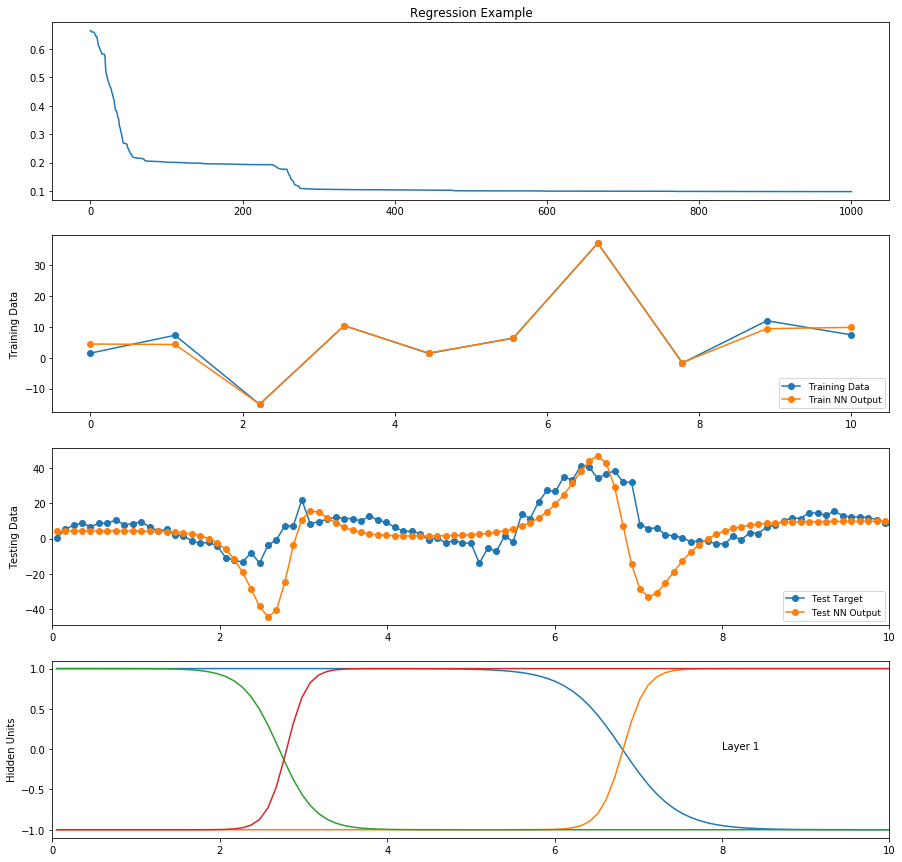

In [56]:
import neuralnetworks as nn
import imp
imp.reload(nn)  # in case neuralnetworks.py has been changed

# Make some training data
nSamples = 10
Xtrain = np.linspace(0, 10, nSamples).reshape((-1, 1))
Ttrain = 1.5 + 0.6 * Xtrain + 8 * np.sin(2.2 * Xtrain)
Ttrain[np.logical_and(Xtrain > 2, Xtrain < 3)] *= 3
Ttrain[np.logical_and(Xtrain > 5, Xtrain < 7)] *= 3

nSamples = 100
Xtest = np.linspace(0, 10, nSamples).reshape((-1, 1)) + 10.0/nSamples/2
Ttest = 1.5 + 0.6 * Xtest + 8 * np.sin(2.2  *Xtest) + np.random.uniform(-2, 2, size=(nSamples, 1))
Ttest[np.logical_and(Xtest > 2, Xtest < 3)] *= 3
Ttest[np.logical_and(Xtest > 5, Xtest < 7)] *= 3

# Create the neural network, with one hidden layer of 4 units
nnet = nn.NeuralNetwork(1, [4], 1)

# Train the neural network
nnet.train(Xtrain, Ttrain, n_epochs=1000)

# Print some information when done
print('SCG stopped after', nnet.get_n_epochs(), 'iterations:', nnet.reason)
print('Training took', nnet.get_training_time(), 'seconds.')

# Print the training and testing RMSE
Ytrain = nnet.use(Xtrain)
Ytest, Ztest = nnet.use(Xtest, all_outputs=True)
print("Final RMSE: train", np.sqrt(np.mean((Ytrain - Ttrain)**2)),
      "test", np.sqrt(np.mean((Ytest - Ttest)**2)))

plt.figure(figsize=(15, 15))

n_hidden_layers = len(nnet.n_hiddens_list)
nPlotRows = 3 + n_hidden_layers

plt.subplot(nPlotRows, 1, 1)
plt.plot(nnet.get_error_trace())
plt.title('Regression Example')

plt.subplot(nPlotRows, 1, 2)
plt.plot(Xtrain, Ttrain, 'o-', label='Training Data')
plt.plot(Xtrain, Ytrain, 'o-', label='Train NN Output')
plt.ylabel('Training Data')
plt.legend(loc='lower right', prop={'size': 9})

plt.subplot(nPlotRows, 1, 3)
plt.plot(Xtest, Ttest, 'o-', label='Test Target')
plt.plot(Xtest, Ytest, 'o-', label='Test NN Output')
plt.ylabel('Testing Data')
plt.xlim(0, 10)
plt.legend(loc='lower right', prop={'size': 9})
for i in range(n_hidden_layers):
    layer = n_hidden_layers - i - 1
    plt.subplot(nPlotRows, 1, i + 4)
    plt.plot(Xtest, Ztest[layer])
    plt.xlim(0,10)
    plt.ylim(-1.1,1.1)
    plt.ylabel('Hidden Units')
    plt.text(8,0, 'Layer {}'.format(layer+1))

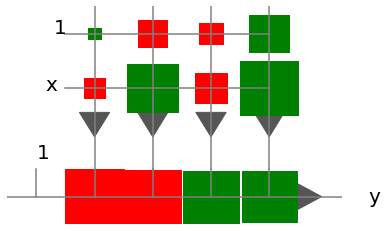

In [57]:
nnet.draw(['x'],['y'])

In [58]:
nnet

NeuralNetwork(1, [4], 1)
   Network was trained for 1001 epochs that took 0.2943 seconds. Final error is 0.09778141409159251

What happens if we add another two hidden layers, for a total of three hidden layers?  Let's use 5 units in each hidden layer.

In [59]:
nnet = nn.NeuralNetwork(1, [5, 5], 1)

In [60]:
nnet

NeuralNetwork(1, [5, 5], 1)  Network is not trained.

The rest of the code is the same.  Even the plotting code written above works for as many hidden layers as we create.

SCG stopped after 501 iterations: limit on machine precision
Final RMSE: train 3.113420848433265e-08 test 4.452596182722343


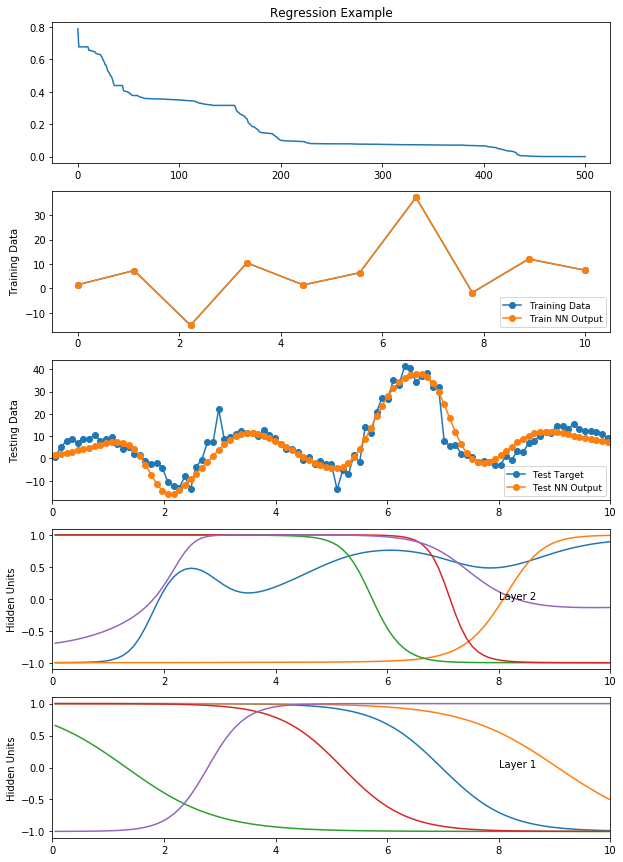

In [61]:
nnet.train(Xtrain, Ttrain, 1000)
print("SCG stopped after", nnet.get_n_epochs(), "iterations:", nnet.reason)
Ytrain = nnet.use(Xtrain)
Ytest, Ztest = nnet.use(Xtest, all_outputs=True)
print("Final RMSE: train", np.sqrt(np.mean((Ytrain - Ttrain)**2)),
      "test", np.sqrt(np.mean((Ytest - Ttest)**2)))

plt.figure(figsize=(10, 15))

n_hidden_layers = len(nnet.n_hiddens_list)
nPlotRows = 3 + n_hidden_layers

plt.subplot(nPlotRows, 1, 1)
plt.plot(nnet.get_error_trace())
plt.title('Regression Example')

plt.subplot(nPlotRows, 1, 2)
plt.plot(Xtrain, Ttrain, 'o-', label='Training Data')
plt.plot(Xtrain, Ytrain, 'o-', label='Train NN Output')
plt.ylabel('Training Data')
plt.legend(loc='lower right', prop={'size': 9})

plt.subplot(nPlotRows, 1, 3)
plt.plot(Xtest, Ttest, 'o-', label='Test Target')
plt.plot(Xtest, Ytest, 'o-', label='Test NN Output')
plt.ylabel('Testing Data')
plt.xlim(0, 10)
plt.legend(loc='lower right', prop={'size': 9})
for i in range(n_hidden_layers):
    layer = n_hidden_layers - i - 1
    plt.subplot(nPlotRows, 1, i + 4)
    plt.plot(Xtest, Ztest[layer])
    plt.xlim(0, 10)
    plt.ylim(-1.1, 1.1)
    plt.ylabel('Hidden Units')
    plt.text(8, 0, 'Layer {}'.format(layer + 1))

For more fun, wrap the above code in a function to make it easy to try different network structures.

In [62]:
def run(Xtrain, Ttrain, Xtest, Ttest, hiddenUnits, n_epochs, verbose=False):
    if Xtrain.shape[1] != 1 or Ttrain.shape[1] != 1:
        print('This function written for one-dimensional input samples, X, and one-dimensional targets, T.')
        return
    
    nnet = nn.NeuralNetwork(1, hiddenUnits,1 )

    nnet.train(Xtrain, Ttrain, n_epochs, verbose=verbose)

    Ytrain = nnet.use(Xtrain)
    Ytest, Ztest = nnet.use(Xtest, all_outputs=True)
    print('Training took {:.4f} seconds.'.format(nnet.get_training_time()))
    print("Final RMSE: train", np.sqrt(np.mean((Ytrain - Ttrain)**2)),
          "test", np.sqrt(np.mean((Ytest - Ttest)**2)))

    plt.figure(figsize=(10, 15))
    nPlotRows = 3 + nnet.n_hidden_layers

    plt.subplot(nPlotRows, 1, 1)
    plt.plot(nnet.get_error_trace())
    plt.title('Regression Example')

    plt.subplot(nPlotRows, 1, 2)
    plt.plot(Xtrain, Ttrain, 'o-', label='Training Data')
    plt.plot(Xtrain, Ytrain, 'o-', label='Train NN Output')
    plt.ylabel('Training Data')
    plt.legend(loc='lower right', prop={'size': 9})

    plt.subplot(nPlotRows, 1, 3)
    plt.plot(Xtest, Ttest, 'o-', label='Test Target')
    plt.plot(Xtest, Ytest, 'o-', label='Test NN Output')
    plt.ylabel('Testing Data')
    plt.xlim(0, 10)
    plt.legend(loc='lower right', prop={'size': 9})
    for i in range(nnet.n_hidden_layers):
        layer = nnet.n_hidden_layers - i - 1
        plt.subplot(nPlotRows, 1, i+4)
        plt.plot(Xtest, Ztest[layer])
        plt.xlim(0, 10)
        plt.ylim(-1.1, 1.1)
        plt.ylabel('Hidden Units')
        plt.text(8, 0, 'Layer {}'.format(layer+1))
    return nnet

Training took 0.3332 seconds.
Final RMSE: train 3.9450662174863917 test 8.176011106827476


NeuralNetwork(1, [2, 2], 1)
   Network was trained for 1001 epochs that took 0.3332 seconds. Final error is 0.2221495000937665

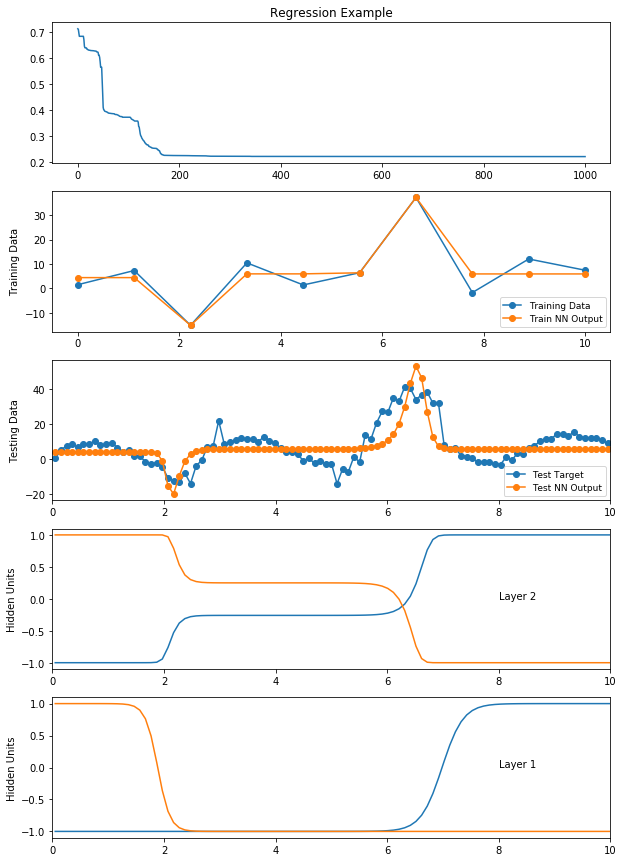

In [63]:
run(Xtrain, Ttrain, Xtest, Ttest, [2, 2], 1000)

Training took 0.4847 seconds.
Final RMSE: train 5.506432773412247 test 12.907296544520227


NeuralNetwork(1, [2, 2, 2, 2], 1)
   Network was trained for 1001 epochs that took 0.4847 seconds. Final error is 0.31007116749813657

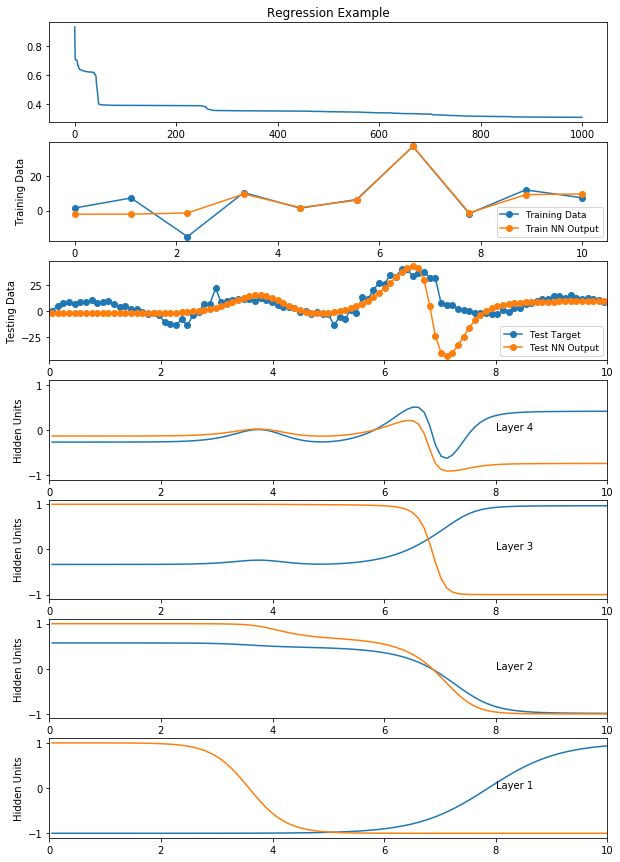

In [64]:
run(Xtrain, Ttrain, Xtest, Ttest, [2, 2, 2, 2], 1000)

In [65]:
[2]*6

[2, 2, 2, 2, 2, 2]

Training took 2.5523 seconds.
Final RMSE: train 3.129261607694991 test 9.37842832046407


NeuralNetwork(1, [2, 2, 2, 2, 2, 2], 1)
   Network was trained for 4001 epochs that took 2.5523 seconds. Final error is 0.17621095907864984

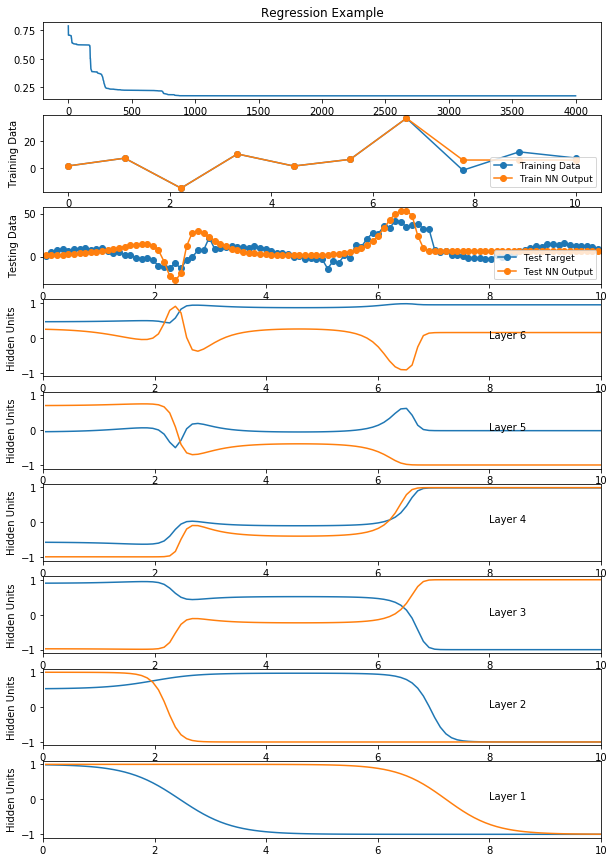

In [66]:
run(Xtrain, Ttrain, Xtest, Ttest, [2]*6, 4000)

Can you say "deep learning"?

This last example doesn't always work.  Depends a lot on good initial random weight values. Go back to the above cell and run it again and again, until you see it not work.

Training took 0.8709 seconds.
Final RMSE: train 3.70053677701748 test 18.667272019248283


NeuralNetwork(1, [50, 10, 3, 1, 3, 10, 50], 1)
   Network was trained for 1001 epochs that took 0.8709 seconds. Final error is 0.20837987242120784

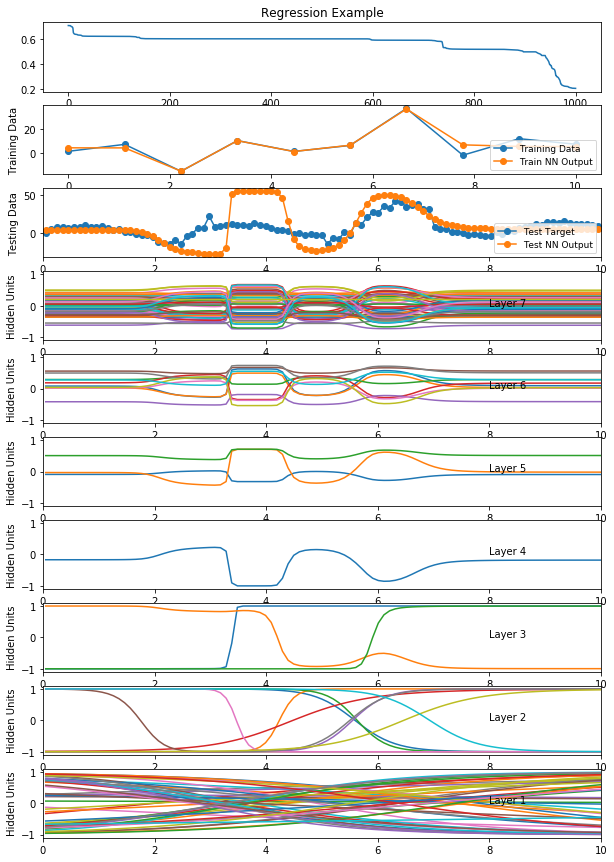

In [67]:
nnet = run(Xtrain, Ttrain, Xtest, Ttest, [50,10,3,1,3,10,50], 1000)
nnet

Run the above cell several times to see very different solutions as observed in the pattern of hidden layer outputs.

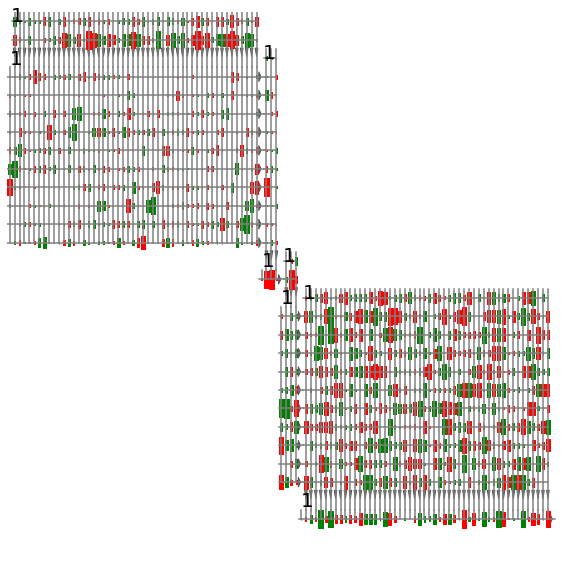

In [68]:
plt.figure(figsize=(10, 10))
nnet.draw()

Let's try saving the weights after each iteration and then make a movie showing how the outputs of each layer change as the network is trained.

In [69]:
def run(Xtrain, Ttrain, hiddenUnits, n_epochs, verbose=False, save_weights_history=False):
    if Xtrain.shape[1] != 1 or Ttrain.shape[1] != 1:
        print('This function written for one-dimensional input samples, X, and one-dimensional targets, T.')
        return
    nnet = nn.NeuralNetwork(1, hiddenUnits,1 )
    nnet.train(Xtrain, Ttrain, n_epochs, verbose=verbose, save_weights_history=save_weights_history)
    return nnet

In [70]:
nnet = run(Xtrain, Ttrain, [50,10,3,1,3,10,50], 500, verbose=False, save_weights_history=True)
nnet

NeuralNetwork(1, [50, 10, 3, 1, 3, 10, 50], 1)
   Network was trained for 501 epochs that took 0.4695 seconds. Final error is 0.10414147128832901

In [71]:
nnet = run(Xtrain, Ttrain, [10, 5, 5], 1000, verbose=False, save_weights_history=True)
nnet

NeuralNetwork(1, [10, 5, 5], 1)
   Network was trained for 544 epochs that took 0.2637 seconds. Final error is 1.2885189286278922e-09

In [72]:
from matplotlib import animation, rc
# from IPython.display import HTML
rc('animation', html='jshtml')
rc('animation', embed_limit=50)

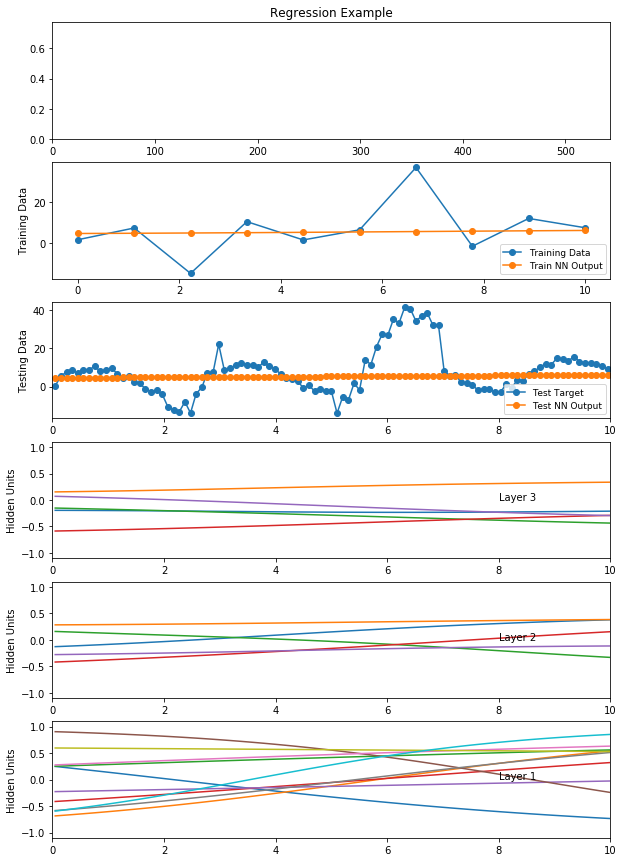

In [84]:
weight_history = nnet.get_weight_history()
nnet._unpack(weight_history[0, :])
Ytrain = nnet.use(Xtrain)
Ytest, Ztest = nnet.use(Xtest, all_outputs=True)

nPlotRows = 3 + nnet.n_hidden_layers

fig = plt.figure(figsize=(10, 15))
plt.subplot(nPlotRows, 1, 1)
errors = nnet.get_error_trace()
errorsLine = plt.plot(0,errors[0])[0]
plt.xlim(0,len(errors))
plt.ylim(0,np.max(errors)*1.1)

plt.title('Regression Example')

plt.subplot(nPlotRows, 1, 2)
plt.plot(Xtrain, Ttrain, 'o-', label='Training Data')
trainLine = plt.plot(Xtrain, Ytrain, 'o-', label='Train NN Output')[0]
plt.ylabel('Training Data')
plt.legend(loc='lower right', prop={'size': 9})

plt.subplot(nPlotRows, 1, 3)
plt.plot(Xtest, Ttest, 'o-', label='Test Target')
testLine = plt.plot(Xtest, Ytest, 'o-', label='Test NN Output')[0]
plt.ylabel('Testing Data')
plt.xlim(0, 10)
plt.legend(loc='lower right', prop={'size': 9})
hiddenOutputLines = []
for i in range(nnet.n_hidden_layers):
    layer = nnet.n_hidden_layers - i - 1
    plt.subplot(nPlotRows, 1, i+4)
    hiddenOutputLines.append( plt.plot(Xtest, Ztest[layer]) )
    plt.xlim(0, 10)
    plt.ylim(-1.1, 1.1)
    plt.ylabel('Hidden Units')
    plt.text(8, 0, 'Layer {}'.format(layer+1))
    
updatesPerFrame = 4

def animator(framei):
    step = framei * updatesPerFrame
    nnet._unpack(weight_history[step,:])
    Ytrain = nnet.use(Xtrain)
    Ytest, Ztest = nnet.use(Xtest, all_outputs=True)
    errorsLine.set_data(range(step),errors[:step])
    trainLine.set_ydata(Ytrain)
    testLine.set_ydata(Ytest)
    
    for iLayer in range(len(hiddenOutputLines)):
        HOLines = hiddenOutputLines[iLayer]
        Zlayer = Ztest[nnet.n_hidden_layers - iLayer - 1]
        for iUnit in range(len(HOLines)):
            HOLines[iUnit].set_ydata(Zlayer[:,iUnit])
    return [errorsLine, trainLine, testLine] + hiddenOutputLines

In [85]:
nFrames = len(nnet.get_error_trace()) // updatesPerFrame # integer divide
anim = animation.FuncAnimation(fig, animator, frames=nFrames, interval=50, blit=False)

In [86]:
# HTML(anim.to_html5_video())
# HTML(anim.to_jshtml())
anim